In [2]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
%cd /content/drive/MyDrive/Kang

/content/drive/MyDrive/Kang


In [3]:
!git clone https://github.com/roboflow-ai/keras-yolo3

Cloning into 'keras-yolo3'...
remote: Enumerating objects: 169, done.
remote: Total 169 (delta 0), reused 0 (delta 0), pack-reused 169
Receiving objects: 100% (169/169), 172.74 KiB | 6.40 MiB/s, done.
Resolving deltas: 100% (80/80), done.


In [4]:
%cd /content/drive/MyDrive/Kang/keras-yolo3

/content/drive/MyDrive/Kang/keras-yolo3


In [5]:
!wget https://pjreddie.com/media/files/yolov3.weights

--2023-07-11 07:44:22--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights’

yolov3.weights      100%[===================>] 236.52M  20.3MB/s    in 13s     

2023-07-11 07:44:35 (18.7 MB/s) - ‘yolov3.weights’ saved [248007048/248007048]



In [6]:
!python convert.py yolov3.cfg yolov3.weights model_data/yolo.h5

2023-07-11 07:44:50.829016: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-11 07:44:51.678808: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Loading weights.
Weights Header:  0 2 0 [32013312]
Parsing Darknet config.
Creating Keras model.
Parsing section net_0
Parsing section convolutional_0
conv2d bn leaky (3, 3, 3, 32)
2023-07-11 07:44:53.273058: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-07-11 07:44:53.850313: I tenso

# **Loading pre trained YOLOv3 trained on COCO (80 classes)**

In [4]:
from tensorflow import keras

In [5]:
model = keras.models.load_model('/content/drive/MyDrive/Kang/final_model_5Currency_withboxlayers.h5')

In [6]:
from keras.utils.vis_utils import plot_model

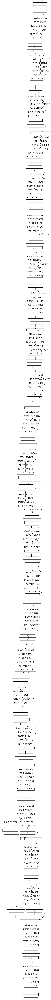

In [ ]:
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

# **Modifying the 3 , output layers (extending for one more class)**

In [7]:
#removing conv2d_74

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense

# Get the second last layer of the model
second_last_layer = model.get_layer('leaky_re_lu_71')
last_layer_2 = model.get_layer('conv2d_new2')
last_layer_3 = model.get_layer('conv2d_new3')

# Remove the last layer
model = Model(inputs=model.input, outputs=[second_last_layer.output,last_layer_2.output,last_layer_3.output])

In [ ]:
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [8]:
#adding a new conv2d layer of 258 nodes
import tensorflow as tf

# Set the output of the model
last_layer_2 = model.get_layer('conv2d_new2')
last_layer_3 = model.get_layer('conv2d_new3')
model.outputs = [model.get_layer('leaky_re_lu_71').output]

from tensorflow.keras.layers import Conv2D

new_conv_layer = Conv2D(273, (1, 1), padding='same', activation='relu',name='conv2d_new1')
output = new_conv_layer(model.outputs[0])
output =[output,last_layer_2.output,last_layer_3.output]

# Create the new model with the updated architecture
model2 = tf.keras.models.Model(inputs=model.inputs, outputs=output)

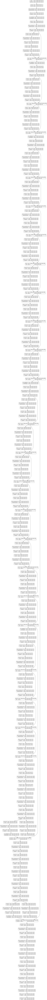

In [ ]:
plot_model(model2, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
#doing same thing with the other 2 output locations

In [9]:
#removing conv2d_66

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense

# Get the second last layer of the model
second_last_layer = model2.get_layer('leaky_re_lu_64')
last_layer_2 = model2.get_layer('conv2d_new1')
last_layer_3 = model2.get_layer('conv2d_new3')

# Remove the last layer
model2 = Model(inputs=model2.input, outputs=[second_last_layer.output,last_layer_2.output,last_layer_3.output])

In [10]:
#adding a new conv2d layer of 258 nodes
import tensorflow as tf

# Set the output of the model
last_layer_2 = model2.get_layer('conv2d_new3')
last_layer_3 = model2.get_layer('conv2d_new1')
model.outputs = [model2.get_layer('leaky_re_lu_64').output]

from tensorflow.keras.layers import Conv2D

new_conv_layer = Conv2D(273, (1, 1), padding='same', activation='relu',name='conv2d_new2')
output = new_conv_layer(model.outputs[0])
output =[output,last_layer_2.output,last_layer_3.output]

# Create the new model with the updated architecture
model2 = tf.keras.models.Model(inputs=model2.inputs, outputs=output)

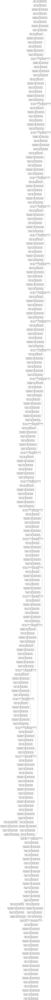

In [ ]:
plot_model(model2, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [11]:
#removing conv2d_58

from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense

# Get the second last layer of the model
second_last_layer = model2.get_layer('leaky_re_lu_57')
last_layer_2 = model2.get_layer('conv2d_new1')
last_layer_3 = model2.get_layer('conv2d_new2')

# Remove the last layer
model2 = Model(inputs=model2.input, outputs=[second_last_layer.output,last_layer_2.output,last_layer_3.output])

In [12]:
#adding a new conv2d layer of 258 nodes
import tensorflow as tf

# Set the output of the model
last_layer_2 = model2.get_layer('conv2d_new2')
last_layer_3 = model2.get_layer('conv2d_new1')
model.outputs = [model2.get_layer('leaky_re_lu_57').output]

from tensorflow.keras.layers import Conv2D

new_conv_layer = Conv2D(273, (1, 1), padding='same', activation='relu',name='conv2d_new3')
output = new_conv_layer(model.outputs[0])
output =[output,last_layer_2.output,last_layer_3.output]

# Create the new model with the updated architecture
model3 = tf.keras.models.Model(inputs=model2.inputs, outputs=output)

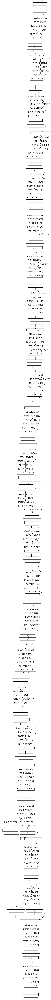

In [ ]:
plot_model(model3, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

# **Storing the pre trained model weights**

In [13]:
pretrained_model = keras.models.load_model('/content/drive/MyDrive/Kang/final_model_5Currency_withboxlayers.h5')

In [28]:
pretrained_weights_1=pretrained_model.get_layer("conv2d_new1").weights

In [29]:
pretrained_weights_2=pretrained_model.get_layer("conv2d_new2").weights

In [30]:
pretrained_weights_3=pretrained_model.get_layer("conv2d_new3").weights

# **Creating custom model with 81 classes**

In [25]:
%cd /content/drive/MyDrive/Kang/keras-yolo3

/content/drive/MyDrive/Kang/keras-yolo3


In [ ]:
%ls

coco_annotation.py  LICENSE              train.py           yolov3.cfg
convert.py          model_data/          Tutorial.ipynb     yolov3-tiny.cfg
darknet53.cfg       model_plot.png       voc_annotation.py  yolov3.weights
font/               README.md            yolo3/             yolo_video.py
kmeans.py           train_bottleneck.py  yolo.py


In [22]:
!curl -L https://universe.roboflow.com/ds/RaNR9GO7jg?key=ehds0elPyj > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   897  100   897    0     0   3384      0 --:--:-- --:--:-- --:--:--  3384
100  245M  100  245M    0     0  31.1M      0  0:00:07  0:00:07 --:--:-- 35.3M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/00017_jpg.rf.28494939e31ecc2e7aa4d9b8d211cc27.jpg  
 extracting: test/00026_jpg.rf.9d735dbae22df0a75a1025de5a6a4a57.jpg  
 extracting: test/00040_jpg.rf.ba432833fbf1656eb0980d6a6550ba67.jpg  
 extracting: test/00046_jpg.rf.dd3e9f6eb7ff54092dcc366f01001e9e.jpg  
 extracting: test/00047_jpg.rf.886de59cc4396a69c8a25c5290c9b0e2.jpg  
 extracting: test/00060_jpg.rf.60517d652ae9069d2fe938e2d6d6afa0.jpg  
 extracting: test/00076_jpg.rf.af263f95e53885b505eda275b7dc6a7c.jpg  
 extracting: test/00100_jpg.rf.04eae57f270be2b54a7df3869c8a6440.jpg  
 extra

In [26]:
!curl -L https://universe.roboflow.com/ds/i6N6KXDEPG?key=lQM6Kp8K0S > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   889  100   889    0     0   3751      0 --:--:-- --:--:-- --:--:--  3751
100 24.8M  100 24.8M    0     0  10.3M      0  0:00:02  0:00:02 --:--:-- 16.1M
Archive:  roboflow.zip
replace README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
 extracting: README.dataset.txt      
replace README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/000000000009_jpg.rf.6acc173402df5523069e146edb03ff4b.jpg  
 extracting: test/000000000025_jpg.rf.ed74f70d3b9ede1832934740b7ac60c7.jpg  
 extracting: test/000000000030_jpg.rf.9b6a40cdb2346d232072517b865b4846.jpg  
 extracting: test/000000000034_jpg.rf.b518abdaed199dcb88854cf20fce8078.jpg  
 extracting: test/000000000036_jpg.rf.236f23e769287f9219fc898a1ab9e716.jpg  
 extracting: test/000000000042_jpg.rf.49cb64

In [15]:
%cd /content/drive/MyDrive/Kang/keras-yolo3/train

/content/drive/MyDrive/Kang/keras-yolo3/train


In [28]:
%mv * ../

In [16]:
%cd ..

/content/drive/MyDrive/Kang/keras-yolo3


In [ ]:
%ls

00002_jpg.rf.b960a79610c80443fb0a4b5ce74aeafe.jpg
00003_jpg.rf.12effdc4de76707f4694ed3f216fbd45.jpg
00006_jpg.rf.a723a682eb1309b59062ea4aee54ee2a.jpg
00009_jpg.rf.dc04e4fc68423226c5c9ca4868c408a2.jpg
00010_jpg.rf.c91bfbb8cb843e8793815cf0d0924ae9.jpg
00012_jpg.rf.37f98b779819fec2368fa0b74822b215.jpg
00013_jpg.rf.67a4585750da615568f81951d2c789f0.jpg
00014_jpg.rf.d42d357502daf4446f3493720457a4c6.jpg
00019_jpg.rf.a4769268770dbbd4ffd752b9b4df99ac.jpg
00021_jpg.rf.d1afa0c63dcbc4c02c50ae0013e5f185.jpg
00022_jpg.rf.50041306ece757161756805b5cedf684.jpg
00023_jpg.rf.907edcd5cad2290208ba736c4a18d384.jpg
00024_jpg.rf.619942f366b3ced23ff8da4f93db0529.jpg
00031_jpg.rf.230a92113fe158b95b26f25f1799cf96.jpg
00032_jpg.rf.0eb70bfe54fd3eaf755a64ac0bd8948f.jpg
00033_jpg.rf.124931ea9c4d71b6d9167619228be32e.jpg
00036_jpg.rf.7e12090130911c43371cd8f801374e09.jpg
00037_jpg.rf.cf049b9d9fdbd265157a0330b869a6b4.jpg
00042_jpg.rf.624ffab09618ecb04f6fb2c946d87253.jpg
00043_jpg.rf.75651a3e13f3d2d537327878707b116f.jpg


# **Training the custom model:**

In [20]:
"""
Self-contained Python script to train YOLOv3 on your own dataset
"""

import numpy as np
import keras.backend as K
from keras.layers import Input, Lambda
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import TensorBoard, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

from yolo3.model import preprocess_true_boxes, yolo_body, tiny_yolo_body, yolo_loss
from yolo3.utils import get_random_data


def _main():
    annotation_path = '_annotations.txt'  # path to Roboflow data annotations
    log_dir = 'logs/000/'                 # where we're storing our logs
    classes_path = '_classes.txt'         # path to Roboflow class names
    anchors_path = 'model_data/yolo_anchors.txt'
    class_names = get_classes(classes_path)
    print("-------------------CLASS NAMES-------------------")
    print(class_names)
    print("-------------------CLASS NAMES-------------------")
    num_classes = len(class_names)
    anchors = get_anchors(anchors_path)

    input_shape = (416,416) # multiple of 32, hw

    # is_tiny_version = len(anchors)==6 # default setting
    # if is_tiny_version:
    #     model = create_tiny_model(input_shape, anchors, num_classes,
    #         freeze_body=2, weights_path='model_data/tiny_yolo_weights.h5')
    # else:
    #     model = create_model(input_shape, anchors, num_classes,
    #         freeze_body=2, weights_path='/content/drive/MyDrive/Kang/final_model_5Currency_withboxlayers.h5') # make sure you know what you freeze

    # logging = TensorBoard(log_dir=log_dir)
    # checkpoint = ModelCheckpoint(log_dir + 'ep{epoch:03d}-loss{loss:.3f}-val_loss{val_loss:.3f}.h5',
    #     monitor='val_loss', save_weights_only=True, save_best_only=True, period=3)
    # reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=1)
    # early_stopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=1)

    # val_split = 0.2 # set the size of the validation set
    # with open(annotation_path) as f:
    #     lines = f.readlines()
    # np.random.seed(10101)
    # np.random.shuffle(lines)
    # np.random.seed(None)
    # num_val = int(len(lines)*val_split)
    # num_train = len(lines) - num_val

    # # Train with frozen layers first, to get a stable loss.
    # # Adjust num epochs to your dataset. This step is enough to obtain a not bad model.
    # if True:
    #     model.compile(optimizer=Adam(lr=1e-3), loss={
    #         # use custom yolo_loss Lambda layer.
    #         'yolo_loss': lambda y_true, y_pred: y_pred})

    #     batch_size = 50
    #     print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
    #     model.fit_generator(data_generator_wrapper(lines[:num_train], batch_size, input_shape, anchors, num_classes),
    #             steps_per_epoch=max(1, num_train//batch_size),
    #             validation_data=data_generator_wrapper(lines[num_train:], batch_size, input_shape, anchors, num_classes),
    #             validation_steps=max(1, num_val//batch_size),
    #             epochs=150,
    #             initial_epoch=0,
    #             callbacks=[logging, checkpoint])
    #     model.save_weights(log_dir + 'trained_weights_stage_1.h5')

    # Unfreeze and continue training, to fine-tune.
    # Train longer if the result is not good.
    # if True:
    #     for i in range(len(model.layers)):
    #         model.layers[i].trainable = True
    #     model.compile(optimizer=Adam(lr=1e-4), loss={'yolo_loss': lambda y_true, y_pred: y_pred}) # recompile to apply the change
    #     print('Unfreeze all of the layers.')

    #     batch_size = 32 # note that more GPU memory is required after unfreezing the body
    #     print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
    #     model.fit_generator(data_generator_wrapper(lines[:num_train], batch_size, input_shape, anchors, num_classes),
    #         steps_per_epoch=max(1, num_train//batch_size),
    #         validation_data=data_generator_wrapper(lines[num_train:], batch_size, input_shape, anchors, num_classes),
    #         validation_steps=max(1, num_val//batch_size),
    #         epochs=100,
    #         initial_epoch=50,
    #         callbacks=[logging, checkpoint, reduce_lr, early_stopping])
    #     model.save_weights(log_dir + 'trained_weights_final.h5')

    # Further training if needed.


def get_classes(classes_path):
    '''loads the classes'''
    with open(classes_path) as f:
        class_names = f.readlines()
    class_names = [c.strip() for c in class_names]
    return class_names

def get_anchors(anchors_path):
    '''loads the anchors from a file'''
    with open(anchors_path) as f:
        anchors = f.readline()
    anchors = [float(x) for x in anchors.split(',')]
    return np.array(anchors).reshape(-1, 2)


def create_model(input_shape, anchors, num_classes, load_pretrained=True, freeze_body=2,
            weights_path='model_data/yolo.h5'):
    '''create the training model'''
    K.clear_session() # get a new session
    image_input = Input(shape=(None, None, 3))
    h, w = input_shape
    num_anchors = len(anchors)

    y_true = [Input(shape=(h//{0:32, 1:16, 2:8}[l], w//{0:32, 1:16, 2:8}[l], \
        num_anchors//3, num_classes+5)) for l in range(3)]

    model_body = yolo_body(image_input, num_anchors//3, num_classes)
    print('Create YOLOv3 model with {} anchors and {} classes.'.format(num_anchors, num_classes))

    if load_pretrained:
        model_body.load_weights(weights_path, by_name=True, skip_mismatch=True)
        print('Load weights {}.'.format(weights_path))
        if freeze_body in [1, 2]:
            # Freeze darknet53 body or freeze all but 3 output layers.
            num = (185, len(model_body.layers)-3)[freeze_body-1]
            for i in range(num): model_body.layers[i].trainable = False
            print('Freeze the first {} layers of total {} layers.'.format(num, len(model_body.layers)))

    model_loss = Lambda(yolo_loss, output_shape=(1,), name='yolo_loss',
        arguments={'anchors': anchors, 'num_classes': num_classes, 'ignore_thresh': 0.5})(
        [*model_body.output, *y_true])
    model = Model([model_body.input, *y_true], model_loss)

    return model

def create_tiny_model(input_shape, anchors, num_classes, load_pretrained=True, freeze_body=2,
            weights_path='model_data/tiny_yolo_weights.h5'):
    '''create the training model, for Tiny YOLOv3'''
    K.clear_session() # get a new session
    image_input = Input(shape=(None, None, 3))
    h, w = input_shape
    num_anchors = len(anchors)

    y_true = [Input(shape=(h//{0:32, 1:16}[l], w//{0:32, 1:16}[l], \
        num_anchors//2, num_classes+5)) for l in range(2)]

    model_body = tiny_yolo_body(image_input, num_anchors//2, num_classes)
    print('Create Tiny YOLOv3 model with {} anchors and {} classes.'.format(num_anchors, num_classes))

    if load_pretrained:
        model_body.load_weights(weights_path, by_name=True, skip_mismatch=True)
        print('Load weights {}.'.format(weights_path))
        if freeze_body in [1, 2]:
            # Freeze the darknet body or freeze all but 2 output layers.
            num = (20, len(model_body.layers)-2)[freeze_body-1]
            for i in range(num): model_body.layers[i].trainable = False
            print('Freeze the first {} layers of total {} layers.'.format(num, len(model_body.layers)))

    model_loss = Lambda(yolo_loss, output_shape=(1,), name='yolo_loss',
        arguments={'anchors': anchors, 'num_classes': num_classes, 'ignore_thresh': 0.7})(
        [*model_body.output, *y_true])
    model = Model([model_body.input, *y_true], model_loss)

    return model

def data_generator(annotation_lines, batch_size, input_shape, anchors, num_classes):
    '''data generator for fit_generator'''
    n = len(annotation_lines)
    i = 0
    while True:
        image_data = []
        box_data = []
        for b in range(batch_size):
            if i==0:
                np.random.shuffle(annotation_lines)
            image, box = get_random_data(annotation_lines[i], input_shape, random=True)
            image_data.append(image)
            box_data.append(box)
            i = (i+1) % n
        image_data = np.array(image_data)
        box_data = np.array(box_data)
        y_true = preprocess_true_boxes(box_data, input_shape, anchors, num_classes)
        yield [image_data, *y_true], np.zeros(batch_size)

def data_generator_wrapper(annotation_lines, batch_size, input_shape, anchors, num_classes):
    n = len(annotation_lines)
    if n==0 or batch_size<=0: return None
    return data_generator(annotation_lines, batch_size, input_shape, anchors, num_classes)

if __name__ == '__main__':
    _main()

-------------------CLASS NAMES-------------------
['aeroplane', 'backpack', 'banana', 'baseball bat', 'baseball glove', 'bear', 'bed', 'bench', 'bicycle', 'bird', 'boat', 'book', 'bottle', 'bowl', 'broccoli', 'bus', 'cake', 'car', 'carrot', 'cat', 'cell phone', 'chair', 'clock', 'cup', 'diningtable', 'dog', 'donut', 'elephant', 'fork', 'frisbee', 'giraffe', 'handbag', 'horse', 'hot dog', 'kite', 'knife', 'laptop', 'microwave', 'motorbike', 'mouse', 'orange', 'oven', 'person', 'pizza', 'pottedplant', 'refrigerator', 'remote', 'sandwich', 'scissors', 'sink', 'skateboard', 'skis', 'snowboard', 'sofa', 'spoon', 'sports ball', 'stop sign', 'suitcase', 'teddy bear', 'tennis racket', 'tie', 'toilet', 'toothbrush', 'traffic light', 'train', 'truck', 'tvmonitor', 'umbrella', 'vase', 'wine glass', 'zebra', 'blah1', 'blah2', 'blah3', 'blah4', 'blah5', 'blah6', 'blah7', 'blah8', 'blah9', '10_Rupees', '100_Rupees', '20_Rupees', '200_Rupees', '50_Rupees', 'Kangaroo']
-------------------CLASS NAMES--

In [17]:
from yolo3.model import yolo_body

In [21]:
class_names = get_classes('/content/drive/MyDrive/Kang/keras-yolo3/_classes.txt')
anchors_path = 'model_data/yolo_anchors.txt'
weights_path = '/content/drive/MyDrive/Kang/keras-yolo3/logs/000/trained_weights_stage_1.h5'
yolo_input_shape = (416, 416)  # Input size of the YOLOv3 model

# Create YOLOv3 model
num_anchors = len(get_anchors(anchors_path))
yolo_model = yolo_body(Input(shape=(None, None, 3)), num_anchors // 3, len(class_names))
yolo_model.load_weights(weights_path)

model_output_path = '/content/drive/MyDrive/Kang/custom_model_86classes.h5'
yolo_model.save(model_output_path)

In [22]:
custom_model = keras.models.load_model('/content/drive/MyDrive/Kang/custom_model_86classes.h5')

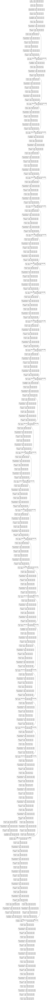

In [24]:
plot_model(custom_model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [25]:
custom_model_weights1=custom_model.get_layer("conv2d_74").weights
custom_model_weights2=custom_model.get_layer("conv2d_66").weights
custom_model_weights3=custom_model.get_layer("conv2d_58").weights

In [ ]:
print(custom_model_weights1[1])

In [ ]:
print(pretrained_weights_1[1])

In [ ]:
print(pretrained_weights_1[0].shape)
print(custom_model_weights1[0].shape)

(1, 1, 256, 255)
(1, 1, 256, 258)


In [ ]:
print(model3.get_layer("conv2d_new1").weights[0].shape)

(1, 1, 256, 258)


# **Combine weights**

In [26]:
import tensorflow as tf

In [53]:
final_model_weights1_first=tf.concat([pretrained_weights_1[0][:,:,:,0:90],custom_model_weights1[0][:,:,:,90:91]],axis=-1)
# final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],pretrained_weights_1[0][:,:,:,5:90]],axis=-1)
# final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],custom_model_weights1[0][:,:,:,90:91]],axis=-1)

final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],pretrained_weights_1[0][:,:,:,90:180]],axis=-1)
final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],custom_model_weights1[0][:,:,:,181:182]],axis=-1)
# final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],pretrained_weights_1[0][:,:,:,95:180]],axis=-1)
# final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],custom_model_weights1[0][:,:,:,181:182]],axis=-1)

final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],pretrained_weights_1[0][:,:,:,180:270]],axis=-1)
final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],custom_model_weights1[0][:,:,:,272:]],axis=-1)
# final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],pretrained_weights_1[0][:,:,:,185:270]],axis=-1)
# final_model_weights1_first=tf.concat([final_model_weights1_first[:,:,:,:],custom_model_weights1[0][:,:,:,272:]],axis=-1)

print(final_model_weights1_first.shape)

#this is the bias weights
final_model_weights1_second=tf.concat([pretrained_weights_1[1][0:90],custom_model_weights1[1][90:91]],axis=0)
# final_model_weights1_second=tf.concat([final_model_weights1_second[:],pretrained_weights_1[1][5:90]],axis=0)
# final_model_weights1_second=tf.concat([final_model_weights1_second[:],custom_model_weights1[1][90:91]],axis=0)

final_model_weights1_second=tf.concat([final_model_weights1_second[:],pretrained_weights_1[1][90:180]], axis=0)
final_model_weights1_second=tf.concat([final_model_weights1_second[:],custom_model_weights1[1][181:182]],axis=0)
# final_model_weights1_second=tf.concat([final_model_weights1_second[:],pretrained_weights_1[1][95:180]], axis=0)
# final_model_weights1_second=tf.concat([final_model_weights1_second[:],custom_model_weights1[1][181:182]], axis=0)

final_model_weights1_second=tf.concat([final_model_weights1_second[:],pretrained_weights_1[1][180:270]], axis=0)
final_model_weights1_second=tf.concat([final_model_weights1_second[:],custom_model_weights1[1][272:]],axis=0)
# final_model_weights1_second=tf.concat([final_model_weights1_second[:],pretrained_weights_1[1][185:270]], axis=0)
# final_model_weights1_second=tf.concat([final_model_weights1_second[:],custom_model_weights1[1][272:]], axis=0)

print(final_model_weights1_second.shape)

(1, 1, 256, 273)
(273,)


In [54]:
final_model_weights2_first=tf.concat([pretrained_weights_2[0][:,:,:,0:90],custom_model_weights2[0][:,:,:,90:91]],axis=-1)
# final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],pretrained_weights_2[0][:,:,:,5:90]],axis=-1)
# final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],custom_model_weights2[0][:,:,:,90:91]],axis=-1)

final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],pretrained_weights_2[0][:,:,:,90:180]],axis=-1)
final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],custom_model_weights2[0][:,:,:,181:182]],axis=-1)
# final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],pretrained_weights_2[0][:,:,:,95:180]],axis=-1)
# final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],custom_model_weights2[0][:,:,:,181:182]],axis=-1)

final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],pretrained_weights_2[0][:,:,:,180:270]],axis=-1)
final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],custom_model_weights2[0][:,:,:,272:]],axis=-1)
# final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],pretrained_weights_2[0][:,:,:,185:270]],axis=-1)
# final_model_weights2_first=tf.concat([final_model_weights2_first[:,:,:,:],custom_model_weights2[0][:,:,:,272:]],axis=-1)

print(final_model_weights2_first.shape)

#this is the bias weights
final_model_weights2_second=tf.concat([pretrained_weights_2[1][0:90],custom_model_weights2[1][90:91]],axis=0)
# final_model_weights2_second=tf.concat([final_model_weights2_second[:],pretrained_weights_2[1][5:90]],axis=0)
# final_model_weights2_second=tf.concat([final_model_weights2_second[:],custom_model_weights2[1][90:91]],axis=0)

final_model_weights2_second=tf.concat([final_model_weights2_second[:],pretrained_weights_2[1][90:180]], axis=0)
final_model_weights2_second=tf.concat([final_model_weights2_second[:],custom_model_weights2[1][181:182]],axis=0)
# final_model_weights2_second=tf.concat([final_model_weights2_second[:],pretrained_weights_2[1][95:180]], axis=0)
# final_model_weights2_second=tf.concat([final_model_weights2_second[:],custom_model_weights2[1][181:182]], axis=0)

final_model_weights2_second=tf.concat([final_model_weights2_second[:],pretrained_weights_2[1][180:270]], axis=0)
final_model_weights2_second=tf.concat([final_model_weights2_second[:],custom_model_weights2[1][272:]],axis=0)
# final_model_weights2_second=tf.concat([final_model_weights2_second[:],pretrained_weights_2[1][185:270]], axis=0)
# final_model_weights2_second=tf.concat([final_model_weights2_second[:],custom_model_weights2[1][272:]], axis=0)

print(final_model_weights2_second.shape)

(1, 1, 512, 273)
(273,)


In [55]:
final_model_weights3_first=tf.concat([pretrained_weights_3[0][:,:,:,0:90],custom_model_weights3[0][:,:,:,90:91]],axis=-1)
# final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],pretrained_weights_3[0][:,:,:,5:90]],axis=-1)
# final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],custom_model_weights3[0][:,:,:,90:91]],axis=-1)

final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],pretrained_weights_3[0][:,:,:,90:180]],axis=-1)
final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],custom_model_weights3[0][:,:,:,181:182]],axis=-1)
# final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],pretrained_weights_3[0][:,:,:,95:180]],axis=-1)
# final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],custom_model_weights3[0][:,:,:,181:182]],axis=-1)

final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],pretrained_weights_3[0][:,:,:,180:270]],axis=-1)
final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],custom_model_weights3[0][:,:,:,272:]],axis=-1)
# final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],pretrained_weights_3[0][:,:,:,185:270]],axis=-1)
# final_model_weights3_first=tf.concat([final_model_weights3_first[:,:,:,:],custom_model_weights3[0][:,:,:,272:]],axis=-1)

print(final_model_weights3_first.shape)

#this is the bias weights
final_model_weights3_second=tf.concat([pretrained_weights_3[1][0:90],custom_model_weights3[1][90:91]],axis=0)
# final_model_weights3_second=tf.concat([final_model_weights3_second[:],pretrained_weights_3[1][5:90]],axis=0)
# final_model_weights3_second=tf.concat([final_model_weights3_second[:],custom_model_weights3[1][90:91]],axis=0)

final_model_weights3_second=tf.concat([final_model_weights3_second[:],pretrained_weights_3[1][90:180]], axis=0)
final_model_weights3_second=tf.concat([final_model_weights3_second[:],custom_model_weights3[1][181:182]],axis=0)
# final_model_weights3_second=tf.concat([final_model_weights3_second[:],pretrained_weights_3[1][95:180]], axis=0)
# final_model_weights3_second=tf.concat([final_model_weights3_second[:],custom_model_weights3[1][181:182]], axis=0)

final_model_weights3_second=tf.concat([final_model_weights3_second[:],pretrained_weights_3[1][180:270]], axis=0)
final_model_weights3_second=tf.concat([final_model_weights3_second[:],custom_model_weights3[1][272:]],axis=0)
# final_model_weights3_second=tf.concat([final_model_weights3_second[:],pretrained_weights_3[1][185:270]], axis=0)
# final_model_weights3_second=tf.concat([final_model_weights3_second[:],custom_model_weights3[1][272:]], axis=0)

print(final_model_weights3_second.shape)

(1, 1, 1024, 273)
(273,)


--------------------

In [56]:
final_layer_weights1=[final_model_weights1_first,final_model_weights1_second]

In [57]:
final_layer_weights2=[final_model_weights2_first,final_model_weights2_second]

In [58]:
final_layer_weights3=[final_model_weights3_first,final_model_weights3_second]

# **setting the weights**

In [59]:
model3.get_layer("conv2d_new1").set_weights(final_layer_weights1)

In [60]:
model3.get_layer("conv2d_new2").set_weights(final_layer_weights2)

In [61]:
model3.get_layer("conv2d_new3").set_weights(final_layer_weights3)

In [62]:
model3.save("/content/drive/MyDrive/Kang/final_model_5currency_plus_kang.h5")

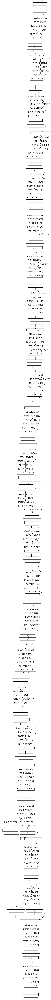

In [ ]:
plot_model(model3, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

# **Use the final model for inference**

In [63]:
final_model=keras.models.load_model("/content/drive/MyDrive/Kang/final_model_5currency_plus_kang.h5")

In [64]:
import tensorflow as tf
from numpy import expand_dims
from keras.models import load_model
from keras.utils import load_img,img_to_array

# load and prepare an image
def load_image_pixels(filename, shape):
    # load the image to get its shape
    image = load_img(filename)
    width, height = image.size
    # load the image with the required size
    image = load_img(filename, target_size=shape)
    # convert to numpy array
    image = img_to_array(image)
    # scale pixel values to [0, 1]
    image = image.astype('float32')
    image /= 255.0
    # add a dimension so that we have one sample
    image = expand_dims(image, 0)
    return image, width, height


# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/mult2.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 2s 2s/step
[(1, 13, 13, 273), (1, 26, 26, 273), (1, 52, 52, 273)]


In [ ]:
import numpy as np

person 99.81443285942078
dog 98.1938123703003
kangaroo 98.5308289527893


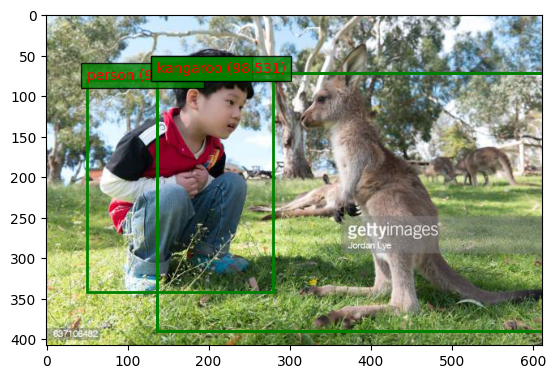

In [65]:
# load yolov3 model and perform object detection
# based on https://github.com/experiencor/keras-yolo3
import numpy as np
from numpy import expand_dims
from keras.models import load_model
from keras.utils import load_img,img_to_array
from matplotlib import pyplot
from matplotlib.patches import Rectangle

class BoundBox:
	def __init__(self, xmin, ymin, xmax, ymax, objness = None, classes = None):
		self.xmin = xmin
		self.ymin = ymin
		self.xmax = xmax
		self.ymax = ymax
		self.objness = objness
		self.classes = classes
		self.label = -1
		self.score = -1

	def get_label(self):
		if self.label == -1:
			self.label = np.argmax(self.classes)

		return self.label

	def get_score(self):
		if self.score == -1:
			self.score = self.classes[self.get_label()]

		return self.score

def _sigmoid(x):
	return 1. / (1. + np.exp(-x))

def decode_netout(netout, anchors, obj_thresh, net_h, net_w):
	grid_h, grid_w = netout.shape[:2]
	nb_box = 3
	netout = netout.reshape((grid_h, grid_w, nb_box, -1))
	nb_class = netout.shape[-1] - 5
	boxes = []
	netout[..., :2]  = _sigmoid(netout[..., :2])
	netout[..., 4:]  = _sigmoid(netout[..., 4:])
	netout[..., 5:]  = netout[..., 4][..., np.newaxis] * netout[..., 5:]
	netout[..., 5:] *= netout[..., 5:] > obj_thresh

	for i in range(grid_h*grid_w):
		row = i / grid_w
		col = i % grid_w
		for b in range(nb_box):
			# 4th element is objectness score
			objectness = netout[int(row)][int(col)][b][4]
			if(objectness.all() <= obj_thresh): continue
			# first 4 elements are x, y, w, and h
			x, y, w, h = netout[int(row)][int(col)][b][:4]
			x = (col + x) / grid_w # center position, unit: image width
			y = (row + y) / grid_h # center position, unit: image height
			w = anchors[2 * b + 0] * np.exp(w) / net_w # unit: image width
			h = anchors[2 * b + 1] * np.exp(h) / net_h # unit: image height
			# last elements are class probabilities
			classes = netout[int(row)][col][b][5:]
			box = BoundBox(x-w/2, y-h/2, x+w/2, y+h/2, objectness, classes)
			boxes.append(box)
	return boxes

def correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w):
	new_w, new_h = net_w, net_h
	for i in range(len(boxes)):
		x_offset, x_scale = (net_w - new_w)/2./net_w, float(new_w)/net_w
		y_offset, y_scale = (net_h - new_h)/2./net_h, float(new_h)/net_h
		boxes[i].xmin = int((boxes[i].xmin - x_offset) / x_scale * image_w)
		boxes[i].xmax = int((boxes[i].xmax - x_offset) / x_scale * image_w)
		boxes[i].ymin = int((boxes[i].ymin - y_offset) / y_scale * image_h)
		boxes[i].ymax = int((boxes[i].ymax - y_offset) / y_scale * image_h)

def _interval_overlap(interval_a, interval_b):
	x1, x2 = interval_a
	x3, x4 = interval_b
	if x3 < x1:
		if x4 < x1:
			return 0
		else:
			return min(x2,x4) - x1
	else:
		if x2 < x3:
			return 0
		else:
			 return min(x2,x4) - x3

def bbox_iou(box1, box2):
	intersect_w = _interval_overlap([box1.xmin, box1.xmax], [box2.xmin, box2.xmax])
	intersect_h = _interval_overlap([box1.ymin, box1.ymax], [box2.ymin, box2.ymax])
	intersect = intersect_w * intersect_h
	w1, h1 = box1.xmax-box1.xmin, box1.ymax-box1.ymin
	w2, h2 = box2.xmax-box2.xmin, box2.ymax-box2.ymin
	union = w1*h1 + w2*h2 - intersect
	return float(intersect) / union

def do_nms(boxes, nms_thresh):
	if len(boxes) > 0:
		nb_class = len(boxes[0].classes)
	else:
		return
	for c in range(nb_class):
		sorted_indices = np.argsort([-box.classes[c] for box in boxes])
		for i in range(len(sorted_indices)):
			index_i = sorted_indices[i]
			if boxes[index_i].classes[c] == 0: continue
			for j in range(i+1, len(sorted_indices)):
				index_j = sorted_indices[j]
				if bbox_iou(boxes[index_i], boxes[index_j]) >= nms_thresh:
					boxes[index_j].classes[c] = 0

# load and prepare an image
def load_image_pixels(filename, shape):
	# load the image to get its shape
	image = load_img(filename)
	width, height = image.size
	# load the image with the required size
	image = load_img(filename, target_size=shape)
	# convert to numpy array
	image = img_to_array(image)
	# scale pixel values to [0, 1]
	image = image.astype('float32')
	image /= 255.0
	# add a dimension so that we have one sample
	image = expand_dims(image, 0)
	return image, width, height

# # get all of the results above a threshold
# def get_boxes(boxes, labels, thresh):
# 	v_boxes, v_labels, v_scores = list(), list(), list()
# 	# enumerate all boxes
# 	for box in boxes:
# 		# enumerate all possible labels
# 		temp1=[]
# 		temp2=[]
# 		temp3=[]
# 		for i in range(len(labels)):
# 				# check if the threshold for this label is high enough
# 			if box.classes[i]>thresh:
# 				if len(temp3)>0:
# 					if temp3[0]<box.classes[i]*100:
# 						temp1[0]=box
# 						temp2[0]=labels[i]
# 						temp3[0]=box.classes[i]*100
# 				else:
# 					temp1.append(box)
# 					temp2.append(labels[i])
# 					temp3.append(box.classes[i]*100)

# 		if(len(temp1)>0):
# 			v_boxes.append(temp1[0])
# 			v_labels.append(temp2[0])
# 			v_scores.append(temp3[0])
# 					# don't break, many labels may trigger for one box
# 	return v_boxes, v_labels, v_scores

def get_boxes(boxes, labels, thresh):
	v_boxes, v_labels, v_scores = list(), list(), list()
	# enumerate all boxes
	for box in boxes:
		# enumerate all possible labels
		for i in range(len(labels)):
			# check if the threshold for this label is high enough
			if box.classes[i] > thresh:
				v_boxes.append(box)
				v_labels.append(labels[i])
				v_scores.append(box.classes[i]*100)
				# don't break, many labels may trigger for one box
	return v_boxes, v_labels, v_scores

# draw all results
def draw_boxes(filename, v_boxes, v_labels, v_scores):
	# load the image
	data = pyplot.imread(filename)
	# plot the image
	pyplot.imshow(data)
	# get the context for drawing boxes
	ax = pyplot.gca()
	# plot each box
	for i in range(len(v_boxes)):
		box = v_boxes[i]
		# get coordinates
		y1, x1, y2, x2 = box.ymin, box.xmin, box.ymax, box.xmax
		# calculate width and height of the box
		width, height = x2 - x1, y2 - y1
		# create the shape
		rect = Rectangle((x1, y1), width, height, fill=False, color='green', linewidth=2)
		# draw the box
		ax.add_patch(rect)
		# draw text and score in top left corner
		label = "%s (%.3f)" % (v_labels[i], v_scores[i])
		pyplot.text(x1, y1, label, color='red', bbox=dict(facecolor='green', alpha=0.8))
	# show the plot
	pyplot.show()


anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# define the labels
labels = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck",
	"boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench",
	"bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe",
	"backpack", "umbrella", "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard",
	"sports ball", "kite", "baseball bat", "baseball glove", "skateboard", "surfboard",
	"tennis racket", "bottle", "wine glass", "cup", "fork", "knife", "spoon", "bowl", "banana",
	"apple", "sandwich", "orange", "broccoli", "carrot", "hot dog", "pizza", "donut", "cake",
	"chair", "sofa", "pottedplant", "bed", "diningtable", "toilet", "tvmonitor", "laptop", "mouse",
	"remote", "keyboard", "cell phone", "microwave", "oven", "toaster", "sink", "refrigerator",
	"book", "clock", "vase", "scissors", "teddy bear", "hair drier", "toothbrush","10_Rupees","100_Rupees","20_Rupees","200_Rupees","50_Rupees","kangaroo"]
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [66]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/kang3.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 1s 1s/step
[(1, 13, 13, 273), (1, 26, 26, 273), (1, 52, 52, 273)]


kangaroo 98.03050756454468
dog 71.82760834693909


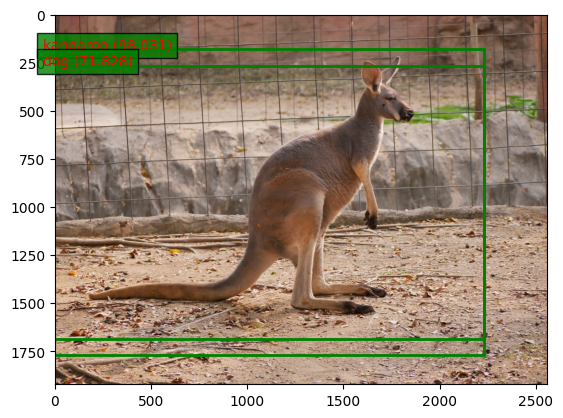

In [67]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [69]:
%cd /content

/content


In [70]:
!wget https://i.pinimg.com/originals/0e/4d/ed/0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg

--2023-07-11 12:13:13--  https://i.pinimg.com/originals/0e/4d/ed/0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg
Resolving i.pinimg.com (i.pinimg.com)... 146.75.28.84, 2600:1408:5400:18::170c:935c, 2600:1408:5400:18::170c:9357
Connecting to i.pinimg.com (i.pinimg.com)|146.75.28.84|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35599 (35K) [image/jpeg]
Saving to: ‘0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg’

0e4ded12fcd6fb8a894 100%[===================>]  34.76K  --.-KB/s    in 0s      

2023-07-11 12:13:13 (81.2 MB/s) - ‘0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg’ saved [35599/35599]



In [71]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/0e4ded12fcd6fb8a894d1f3c8defb9c5.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 1s 1s/step
[(1, 13, 13, 273), (1, 26, 26, 273), (1, 52, 52, 273)]


kangaroo 81.31846189498901
bicycle 77.11281180381775


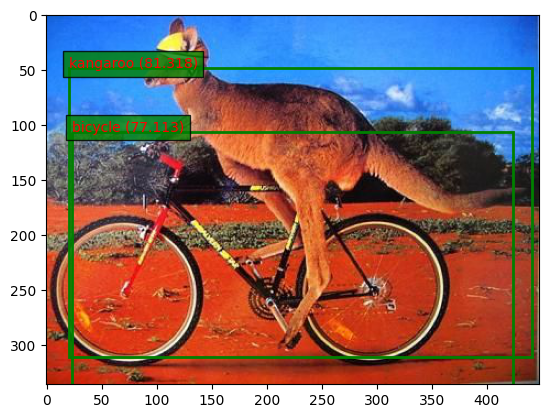

In [72]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [73]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/mult3.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 1s 1s/step
[(1, 13, 13, 273), (1, 26, 26, 273), (1, 52, 52, 273)]


person 99.71811175346375
bicycle 99.39075708389282


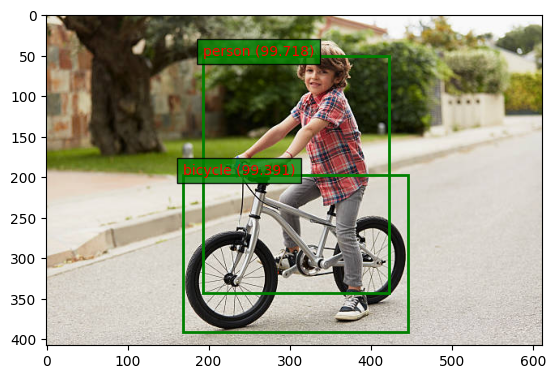

In [74]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [77]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/IMG_20230404_162839_jpg.rf.2ad588b0a405572ead8d0f23508a5d2b.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 1s 1s/step
[(1, 13, 13, 273), (1, 26, 26, 273), (1, 52, 52, 273)]


100_Rupees 64.12988305091858


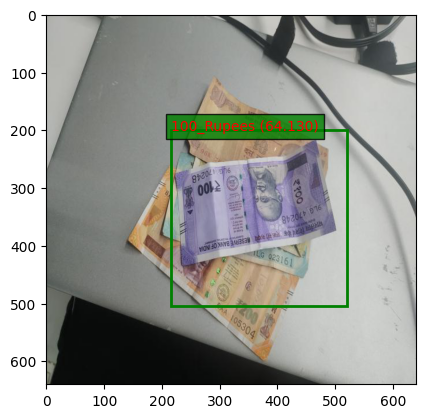

In [78]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [79]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/IMG_20230404_163717_jpg.rf.1002ecb84a956be631f6ce705050afdb.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 1s 1s/step
[(1, 13, 13, 273), (1, 26, 26, 273), (1, 52, 52, 273)]


10_Rupees 84.74752902984619


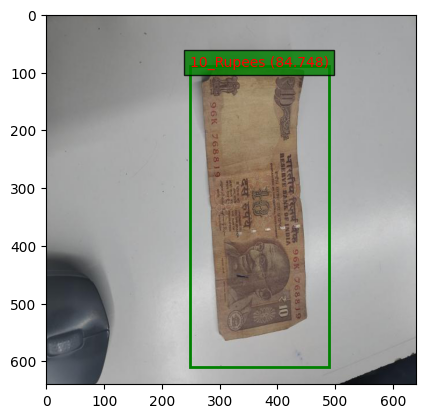

In [80]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

In [81]:
# define the expected input shape for the model
input_w, input_h = 416, 416
# define our new photo
photo_filename = '/content/IMG_20230404_163511_jpg.rf.b4a6339f4e35d04f4fa945df2cf55d4b.jpg'
# load and prepare image
image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
# make prediction
yhat =final_model.predict(image)
# summarize the shape of the list of arrays
print([a.shape for a in yhat])

1/1 [==============================] - 2s 2s/step
[(1, 13, 13, 273), (1, 26, 26, 273), (1, 52, 52, 273)]


book 86.67083382606506
200_Rupees 82.60892629623413


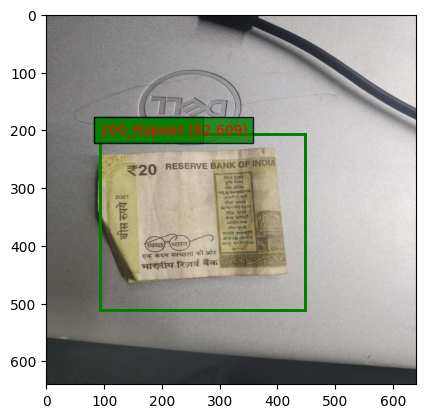

In [82]:
anchors = [[116,90, 156,198, 373,326], [30,61, 62,45, 59,119], [10,13, 16,30, 33,23]]
# define the probability threshold for detected objects
class_threshold = 0.6
boxes = list()
for i in range(len(yhat)):
	# decode the output of the network
	boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)
# correct the sizes of the bounding boxes for the shape of the image
correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)
# suppress non-maximal boxes
do_nms(boxes, 0.5)
# get the details of the detected objects
v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)
# summarize what we found
for i in range(len(v_boxes)):
	print(v_labels[i], v_scores[i])
# draw what we found
draw_boxes(photo_filename, v_boxes, v_labels, v_scores)